# My Task - Reading and processing a binary file

### Part 1

In [15]:
with open("10mb.bin", "br") as bf:
    data=bf.read()

print("The our data:")
for d in data[0:10]:
    print(bin(d),' ' ,end='')
 
bdata=bytearray(data)
print("\n\nFor example: data[1] =",bdata[1])

The our data:
0b11101101  0b10111010  0b10  0b10100010  0b11010010  0b10111110  0b10000010  0b11010101  0b10001  0b11001100  

For example: data[1] = 186


### Part 2

     Examples on creating and styling line charts in Python with Plotly. 

In [1]:
import matplotlib
import cufflinks as cf
import plotly
import plotly.offline as py
import plotly.graph_objs as go

cf.go_offline() # required to use plotly offline (no account required).
py.init_notebook_mode() # graphs charts inline (IPython).


# Create random data with numpy
import numpy as np

N = 100
random_x = np.linspace(0, 10, N)
random_y0 = np.random.randn(N)+5
random_y1 = np.random.randn(N)
random_y2 = np.random.randn(N)-5

# Create traces
trace0 = go.Scatter(
    x = random_x,
    y = random_y0,
    mode = 'lines',
    name = 'lines'
)
trace1 = go.Scatter(
    x = random_x,
    y = random_y1,
    mode = 'lines+markers',
    name = 'lines+markers'
)
trace2 = go.Scatter(
    x = random_x,
    y = random_y2,
    mode = 'markers',
    name = 'markers'
)
data = [trace0, trace1, trace2]

# Edit the layout
layout = dict(title = 'Average High and Low Temperatures in New York',
              xaxis = dict(title = 'Month'),
              yaxis = dict(title = 'Temperature (degrees F)'),
              )

fig = dict(data=data, layout=layout)
py.iplot(fig, filename='styled-line')


In [2]:
import plotly.plotly as py
import plotly.graph_objs as go
import matplotlib
import cufflinks as cf
import plotly
import plotly.offline as py
import plotly.graph_objs as go

cf.go_offline() # required to use plotly offline (no account required).
py.init_notebook_mode() # graphs charts inline (IPython).
labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
values = [4500,2500,1053,500]
colors = ['#FEBFB3', '#E1396C', '#96D38C', '#D0F9B1']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent', textinfo='value', 
               textfont=dict(size=20),
               marker=dict(colors=colors, 
                           line=dict(color='#000000', width=2)))

py.iplot([trace], filename='styled_pie_chart')

In [3]:
import matplotlib
import cufflinks as cf
import plotly
import plotly.offline as py
import plotly.graph_objs as go

import numpy as np

x,y = np.meshgrid(np.arange(0, 2, .2), np.arange(0, 2, .2))
u = np.cos(x)*y
v = np.sin(x)*y

fig = ff.create_quiver(x, y, u, v)
py.iplot(fig, filename='Quiver Plot Example')

NameError: name 'ff' is not defined

# 5.02.2019 Continue. Processing data

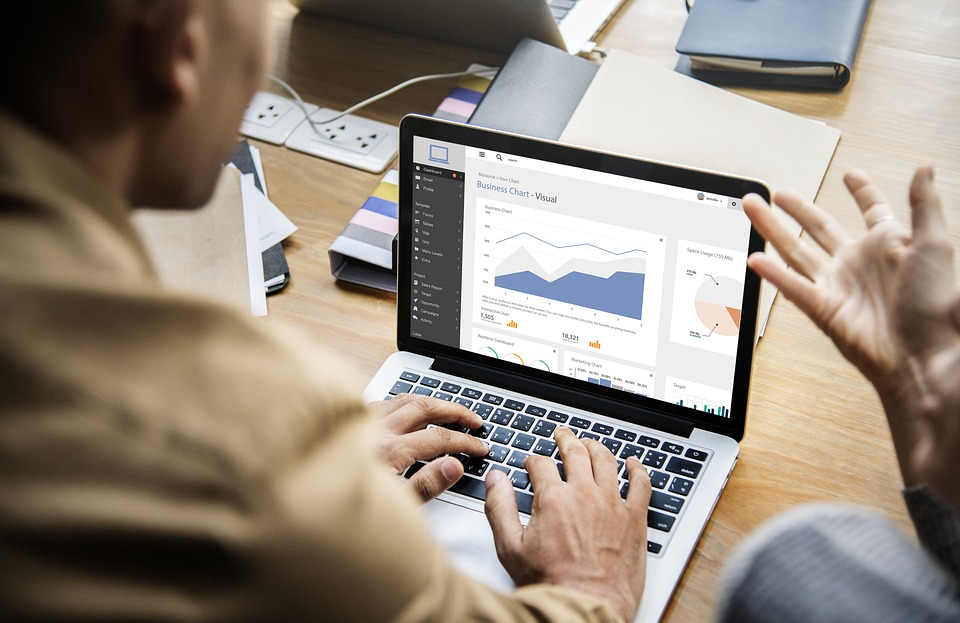

In [59]:
import struct

path = "Result/sigma_0_rho_0_D_T_0_D_R_0_N_100_0_0.bin"
    
def read_binary_file(path):
    try:
        with open("Result/sigma_0_rho_0_D_T_0_D_R_0_N_100_0_0.bin", "br") as bf:
            data=bf.read()
        
        bdata=bytearray(data)
        return bdata
    
    except SyntaxError:
        print("Please, check the specified path")


def count_variables(path):
    # For example path = "sigma_0_rho_0_D_T_0_D_R_0_N_100_0_0.bin"
    try:
        n = int((path.split("N_")[1]).split("_")[0])
        return n
    
    except SyntaxError:
        print("Please, check the specified path")

with open("Result/sigma_0_rho_0_D_T_0_D_R_0_N_100_0_0.bin", "br") as bf:
    #data = struct.unpack('f', bf.read())
    data = np.fromfile(bf, np.float32)
    #data.shape = (64,128)
    print(data)

#data = read_binary_file(path)
n = count_variables(path)

[0.         0.7262492  0.91533935 ... 0.775279   0.6016824  2.4413445 ]


In [65]:
def get_x_y(data, n, t):
    a = (t - 1)*(3*n + 1)
    b = t*(3*n + 1)
    
    x = []
    y = []
    
    i = 0
    for d in range(a,b):
        if (b - a - i)%3 == 0:
            x.append(data[d])
        if (b - a - i + 1)%3 == 0:
            y.append(data[d])
        i = i + 1
    
    print("X: ", x)
    print("Y: ", y)
    return x, y

our_x, our_y =  get_x_y(data, n, 100)

X:  [0.53927225, 0.50992084, 0.6685924, 0.45182514, 0.9564865, 0.10144069, 0.7435618, 0.9862298, 0.73245746, 0.0132367145, 0.068981834, 0.16272257, 0.6946372, 0.9159662, 0.75797737, 0.84364116, 0.29402503, 0.58847034, 0.5978501, 0.9502023, 0.11787542, 0.752388, 0.42644015, 0.5979508, 0.95327526, 0.48912933, 0.8645073, 0.10896897, 0.3083535, 0.93058395, 0.11557066, 0.030769307, 0.6983747, 0.46303678, 0.64693093, 0.25593597, 0.64041483, 0.08633208, 0.406424, 0.55066925, 0.020804677, 0.22825874, 0.29044858, 0.7538371, 0.7966953, 0.24177064, 0.8987538, 0.069901444, 0.27956447, 0.7563129, 0.5242379, 0.43468437, 0.3957689, 0.48067728, 0.62014824, 0.013046676, 0.7464228, 0.14728938, 0.1739107, 0.6268153, 0.9894344, 0.23083775, 0.67038924, 0.3827469, 0.33234096, 0.21831349, 0.79204124, 0.6371717, 0.9082387, 0.37447786, 0.8696821, 0.9561021, 0.4125704, 0.6728869, 0.14092244, 0.8315057, 0.044954147, 0.3214283, 0.8141979, 0.58730716, 0.23031794, 0.56390685, 0.41291282, 0.9555102, 0.7651275, 0.127

In [66]:
import matplotlib
import cufflinks as cf
import plotly
import plotly.offline as py
import plotly.graph_objs as go

import plotly.figure_factory as ff

import numpy as np

def fplot_system_state(time):
    # x = get_x(time)
    # y = get_y(time)
    
    colorscale = ['#7A4579', '#D56073', 'rgb(236,158,105)', (1, 1, 0.2), (0.98,0.98,0.98)]

    fig = ff.create_2d_density(
        our_x, our_y, colorscale=colorscale,
        hist_color='rgb(255, 237, 222)', point_size=3
    )

    py.iplot(fig, filename='histogram_subplots')

def splot_system_state(time):
    # x = get_x(time)
    # y = get_y(time)
    
    N = 1000000
    
    trace = go.Scattergl(
        x = our_x,
        y = our_y,
        
        mode = 'markers',
    
        marker = dict(
            color = 'rgb(152, 0, 0)',
            line = dict(
                width = 1,
                color = 'rgb(0,0,0)')
        )
    )
    
    data = [trace]
    py.iplot(data, filename='WebGLmillion')
    
fplot_system_state(0)
splot_system_state(0)